In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import h5py
import os

/home/apk/anaconda2/lib/python2.7/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [5]:
efile=['ME_4_R2018.10.24_11.46.16.hdf5','ME_9_R2018.10.24_11.52.32.hdf5','ME_10_R2018.10.24_11.54.32.hdf5',
       'ME_14_a2018.10.24_12.04.19.hdf5','ME_14_b2018.10.24_12.06.09.hdf5','ME_14_c2018.10.24_12.08.40.hdf5',
       'ME_14_d2018.10.24_12.10.40.hdf5','ME_2_2018.10.24_11.39.29.hdf5','ME_3_2018.10.24_11.43.35.hdf5',
       'ME_8_2018.10.24_11.48.59.hdf5','ME_11_2018.10.24_11.57.28.hdf5','ME_12_2018.10.24_12.00.55.hdf5',
       'ME_13_2018.10.24_12.02.39.hdf5','ME_15_2018.10.24_12.13.06.hdf5','ME_16_2018.10.24_12.14.06.hdf5',
       'ME_17_2018.10.24_11.36.33.hdf5','MI_2_2018.10.24_11.37.48.hdf5','MI_3_2018.10.24_11.42.16.hdf5',
      'MI_4_2018.10.24_11.45.20.hdf5','MI_8_2018.10.24_11.47.36.hdf5','MI_9_2018.10.24_11.51.39.hdf5',
       'MI_10_2018.10.24_11.53.48.hdf5','MI_11_2018.10.24_11.56.07.hdf5','MI_12_2018.10.24_11.59.59.hdf5',
       'MI_13_2018.10.24_12.02.00.hdf5','MI_14_a2018.10.24_12.03.34.hdf5','MI_14_b2018.10.24_12.05.24.hdf5',
      'MI_14_c2018.10.24_12.07.56.hdf5','MI_14_d2018.10.24_12.09.45.hdf5','MI_15_2018.10.24_12.12.20.hdf5']

In [7]:
for f in efile:
    eeg=h5py.File(f,mode='r')
    print f
    sampletime = np.array(eeg['AsynchronData']["Time"])
    sampletime1=np.delete(sampletime, len(sampletime)-1)
    sampletime1=np.delete(sampletime1, 0)
    if sampletime1[0]/256.0 <=2.0:
        print 'ooh'
        print sampletime1[0]/256.0
    print (eeg['RawData']['Samples'].shape[0]-sampletime1[len(sampletime1)-1])/256.0
    if (eeg['RawData']['Samples'].shape[0]-sampletime1[len(sampletime1)-1])/256.0 <5.0:
        print 'noooo'

ME_4_R2018.10.24_11.46.16.hdf5
3.55078125
noooo
ME_9_R2018.10.24_11.52.32.hdf5
4.703125
noooo
ME_10_R2018.10.24_11.54.32.hdf5
7.5546875
ME_14_a2018.10.24_12.04.19.hdf5
4.72265625
noooo
ME_14_b2018.10.24_12.06.09.hdf5
9.5859375
ME_14_c2018.10.24_12.08.40.hdf5
5.54296875
ME_14_d2018.10.24_12.10.40.hdf5
4.5078125
noooo
ME_2_2018.10.24_11.39.29.hdf5
6.2265625
ME_3_2018.10.24_11.43.35.hdf5
5.640625
ME_8_2018.10.24_11.48.59.hdf5
10.015625
ME_11_2018.10.24_11.57.28.hdf5
6.40234375
ME_12_2018.10.24_12.00.55.hdf5
6.67578125
ME_13_2018.10.24_12.02.39.hdf5
4.21484375
noooo
ME_15_2018.10.24_12.13.06.hdf5
ooh
1.859375
6.65625
ME_16_2018.10.24_12.14.06.hdf5
15.953125
ME_17_2018.10.24_11.36.33.hdf5
9.0390625
MI_2_2018.10.24_11.37.48.hdf5
10.640625
MI_3_2018.10.24_11.42.16.hdf5
9.99609375
MI_4_2018.10.24_11.45.20.hdf5
5.58203125
MI_8_2018.10.24_11.47.36.hdf5
8.78515625
MI_9_2018.10.24_11.51.39.hdf5
5.03515625
MI_10_2018.10.24_11.53.48.hdf5
ooh
1.390625
5.9140625
MI_11_2018.10.24_11.56.07.hdf5
4.9375
n

In [10]:
import scipy.signal as signal
def butter_bandpass(lowcut, fs, order):
    nyq = 0.5 * fs
    low = lowcut / nyq
    
    b, a = signal.butter(order, low, btype='low')
    return b, a

In [8]:
plt.rcParams["figure.figsize"] = [25,16]
path='id6Day7-20190503T212715Z-001'

/home/apk/anaconda2/lib/python2.7/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


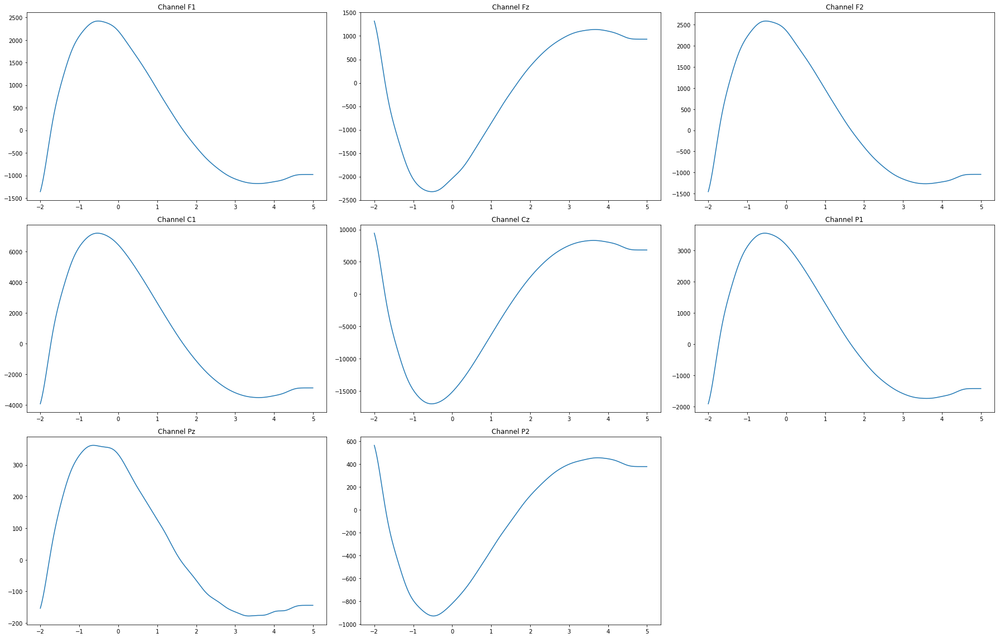

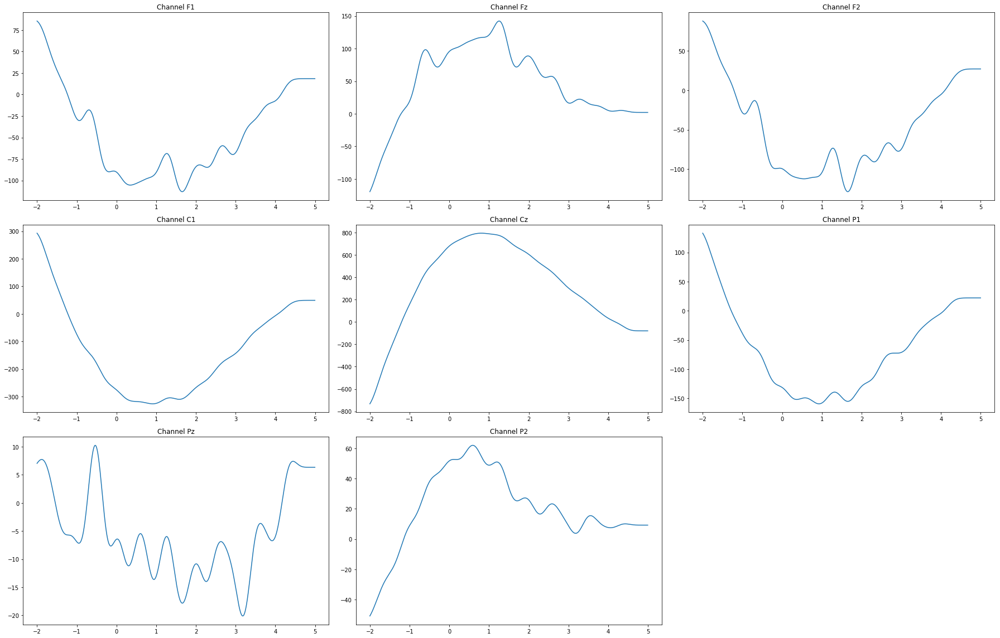

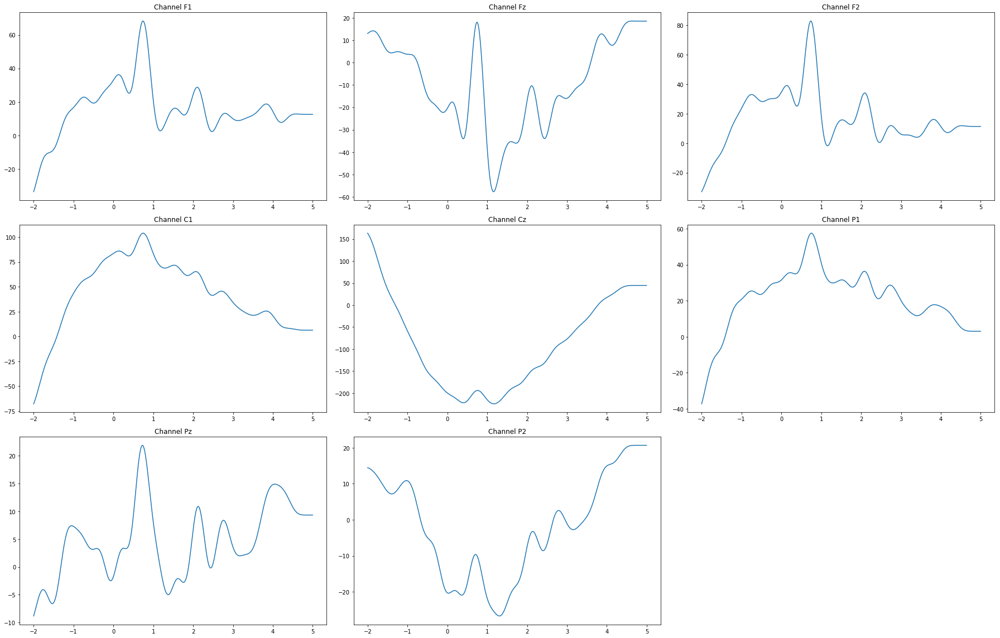

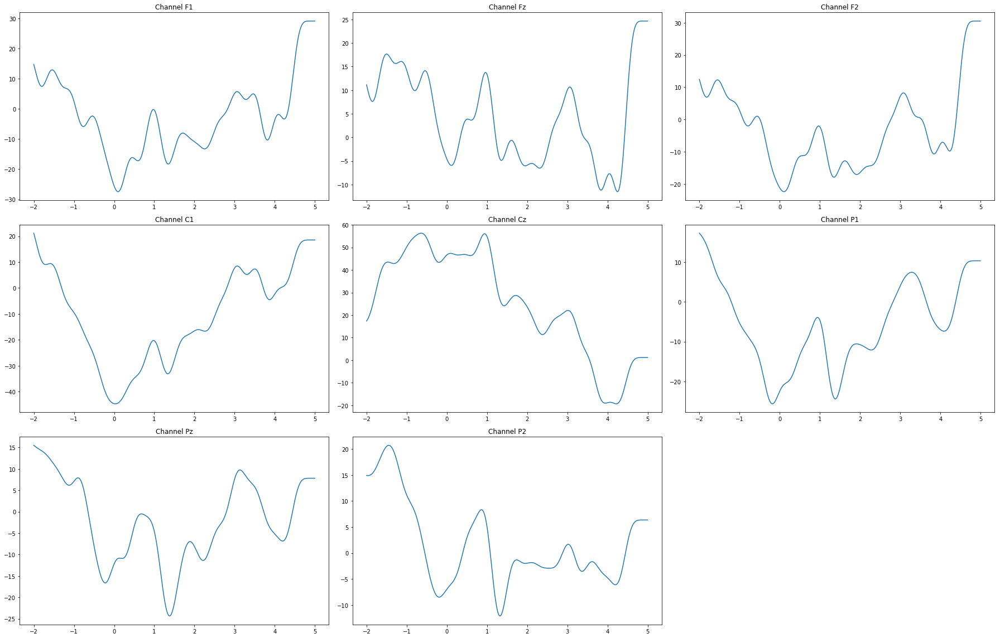

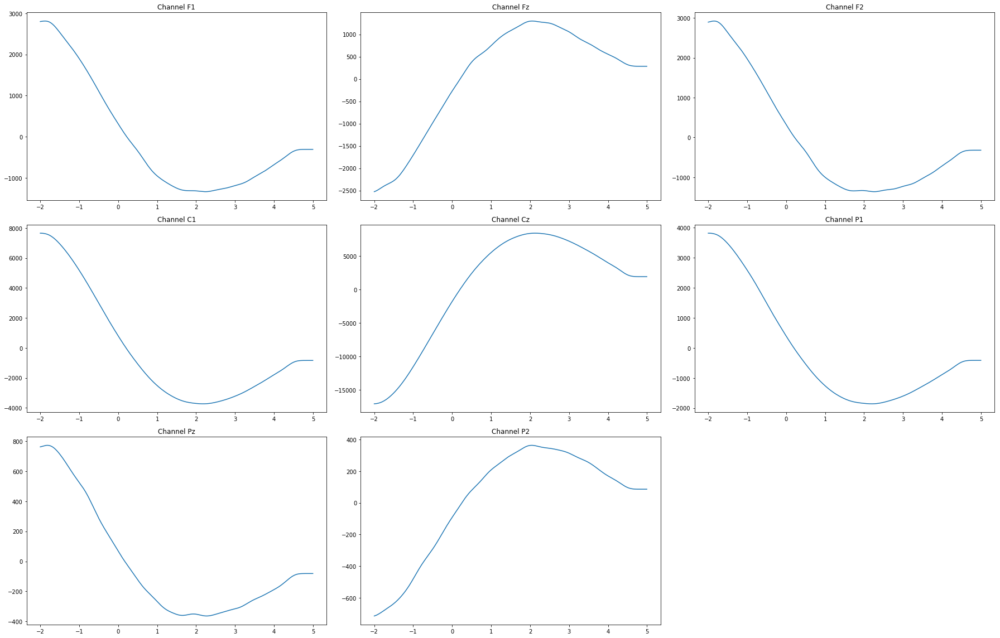

...

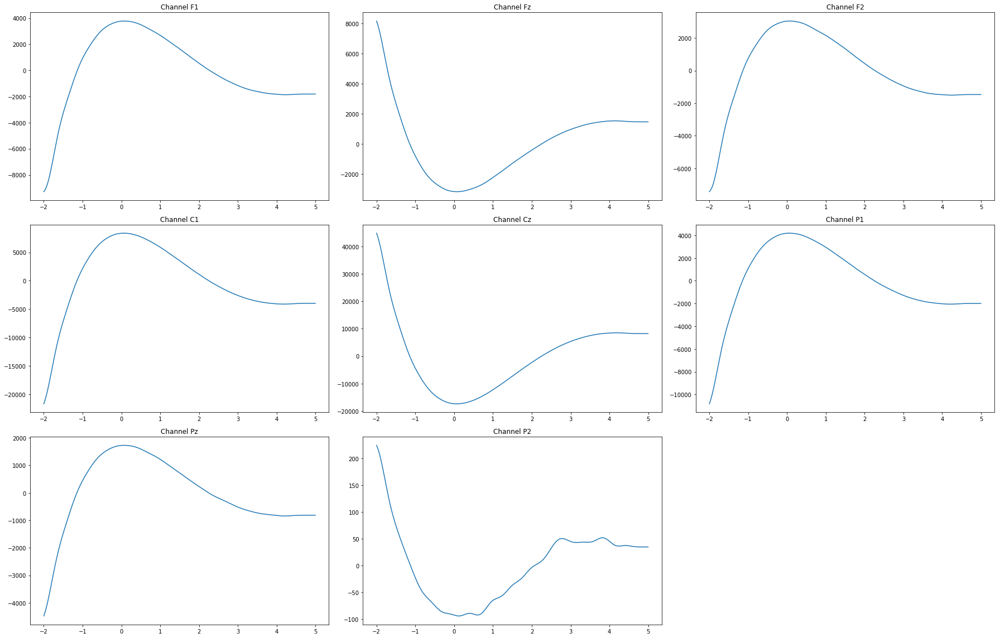

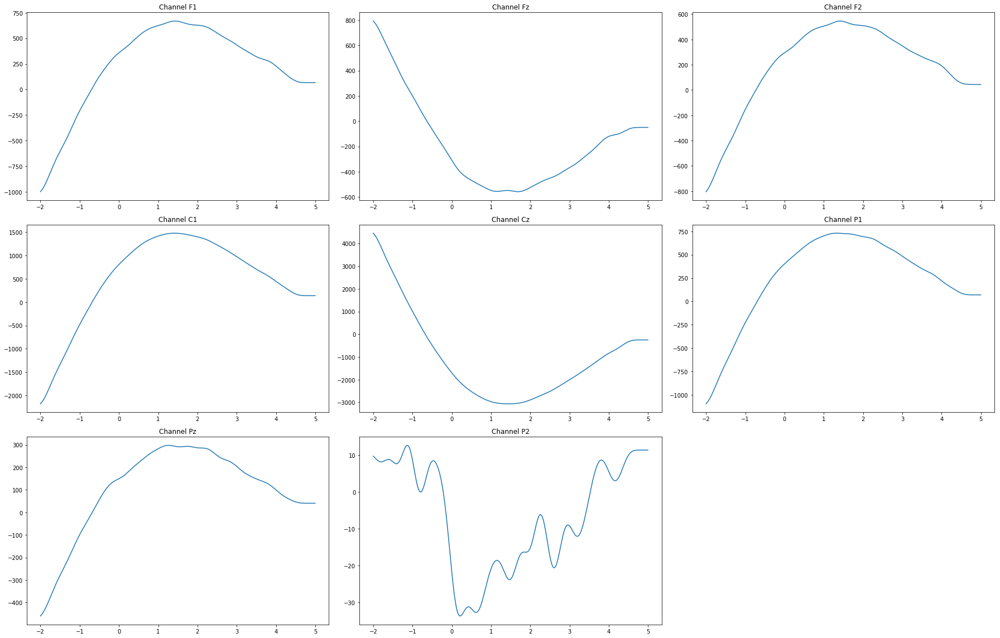

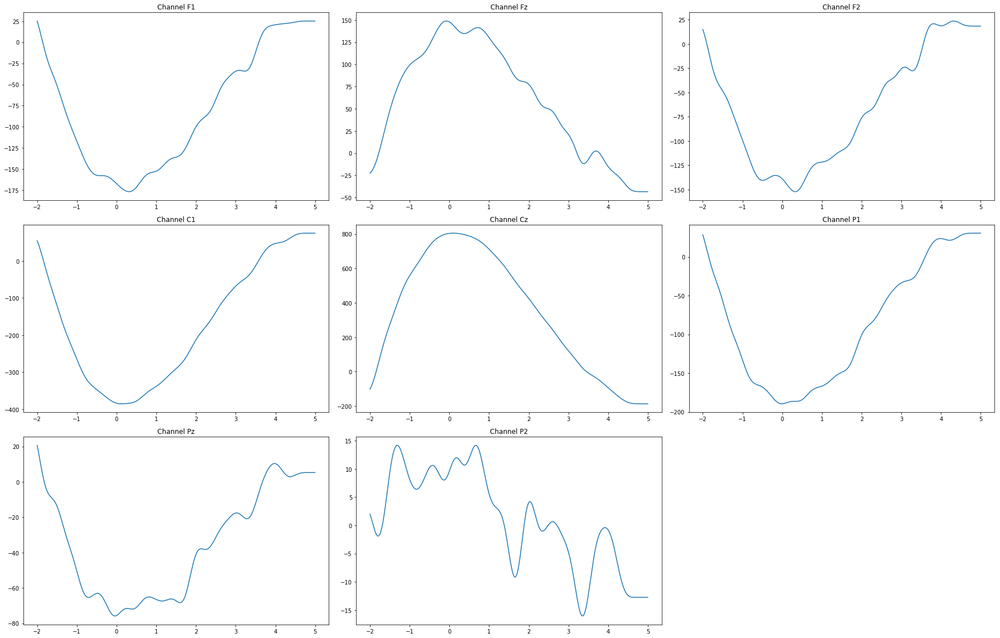

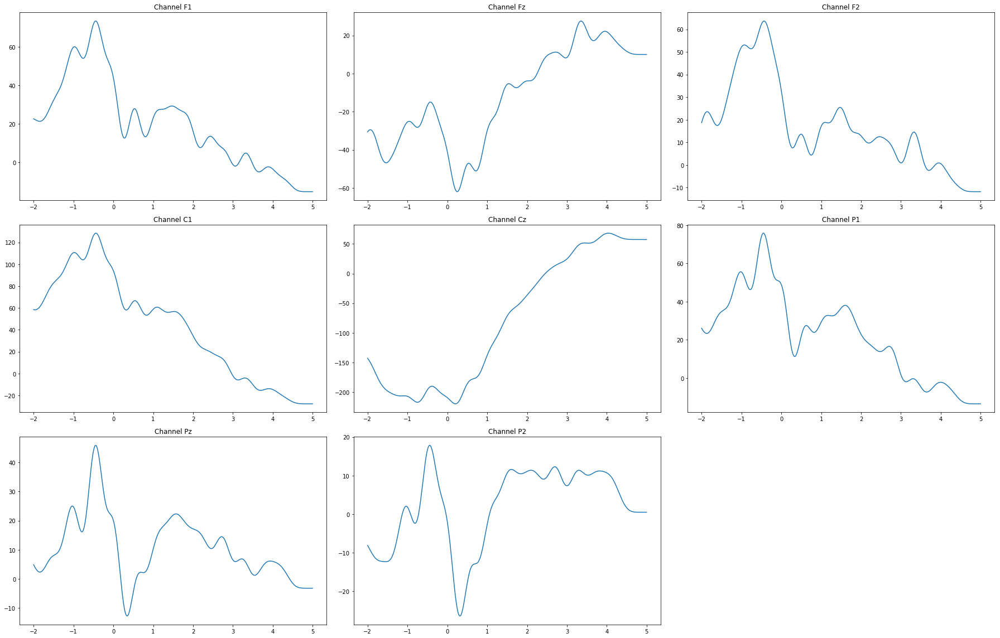

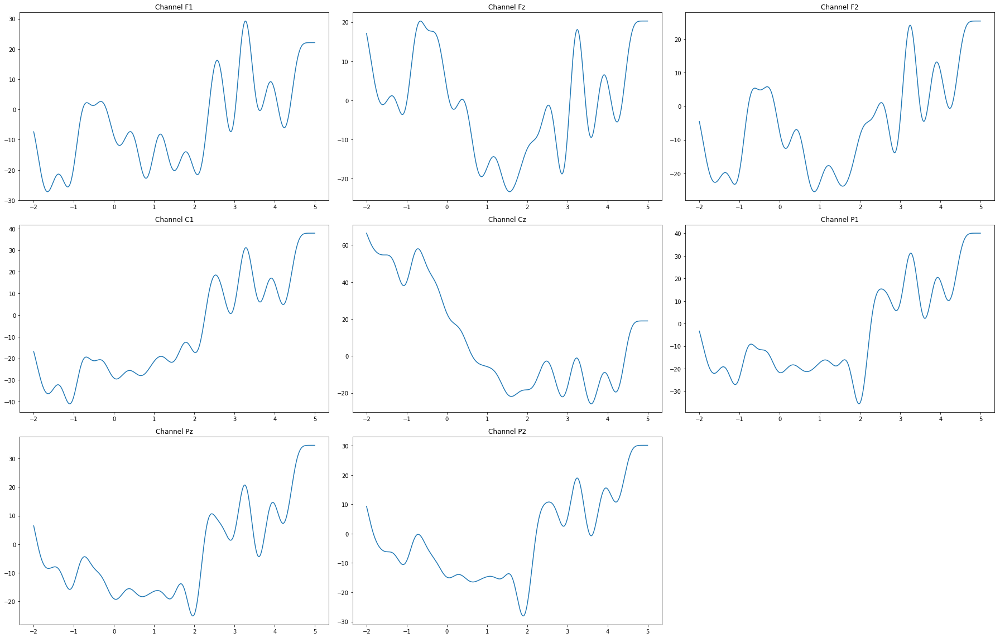

In [12]:
for f in efile:
    m=5.0
    n=2.0
    eeg=h5py.File(f,mode='r')
    sampletime = np.array(eeg['AsynchronData']["Time"])
    sampletime1=np.delete(sampletime, len(sampletime)-1)
    sampletime1=np.delete(sampletime1, 0)
    if (eeg['RawData']['Samples'].shape[0]-sampletime1[len(sampletime1)-1])/256.0 <5.0:
        sampletime1=np.delete(sampletime1, len(sampletime1)-1)
    
    if sampletime1[0]/256.0 <=2.0:
        sampletime1=np.delete(sampletime1, 0)
    samples=np.array(eeg['RawData']['Samples'])
    samples=samples.T
    f1=samples[10]
    fz=samples[11]
    f2=samples[12]
    c1=samples[28]
    cz=samples[29]
    p1=samples[46]
    pz=samples[47]
    p2=samples[48]
    channels=[]
    channels.append(f1)
    channels.append(fz)
    channels.append(f2)
    channels.append(c1)
    channels.append(cz)
    channels.append(p1)
    channels.append(pz)
    channels.append(p2)
    fchannels=[]
    for i in range(0, len(channels)):
        c=[]
        for  j in sampletime1:
            c.append(channels[i][j-2*256:j+int(m)*256])
        fchannels.append(c)
        
    filtered=fchannels
    freq=2
    fs=256
    order=8
    for i in range (0, len(fchannels)):
        for j in range(0, len(fchannels[i])):
            b, a= butter_bandpass(freq, fs, order)
            x=(signal.filtfilt(b, a, fchannels[i][j], padlen=0))
            #x=x*1.0/np.max(x)
            filtered[i][j]=x
            
    
    
    name=f[0:5]
    for j in range(0, len(filtered[0])):
        activity=f+'_'+str(j+1)
        fig = plt.figure()
        plot=fig.add_subplot(3,3,1)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[0][j])
        plt.title('Channel F1')

        plot=fig.add_subplot(3,3,2)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[1][j])
        plt.title('Channel Fz')

        plot=fig.add_subplot(3,3,3)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[2][j])
        plt.title('Channel F2')

        plot=fig.add_subplot(3,3,4)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[3][j])
        plt.title('Channel C1')


        plot=fig.add_subplot(3,3,5)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[4][j])
        plt.title('Channel Cz')

        plot=fig.add_subplot(3,3,6)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[5][j])
        plt.title('Channel P1')

        plot=fig.add_subplot(3,3,7)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[6][j])
        plt.title('Channel Pz')

        plot=fig.add_subplot(3,3,8)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[7][j])
        plt.title('Channel P2')

        plt.tight_layout()
        plt.savefig(path+'/'+activity+'.png')